In [3]:
run ../../Lenia/code/lenia_package  # Load functions

# Modelling gradients
## Qualitative analysis of gradients
Quick look into how sensitive our orbium are to gradients to find good environments to go off of. 

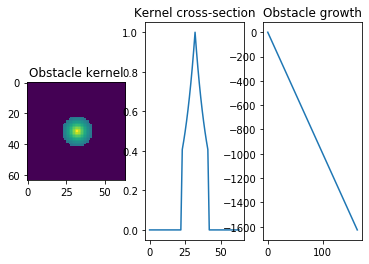

In [4]:
# One single source of negative value
obstacle = ObstacleChannel(n=1, r=10, gradient=1)
obstacle.initiate()
obstacle.figure_asset()

In [5]:
orbium = Creature("orbium")
get_survival_time(orbium, obstacle, runs=10, summary=True)  # Quite a long survival time

(226.0, 117797.4)

In [7]:
orbium.initiate()
obstacle.initiate(seed=2)
orbium.enviro = obstacle.grid
fig = Creature.figure_world(sum([orbium.A, orbium.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, orbium.update_obstacle, frames=200, interval=20).to_jshtml())

Want it to be slightly more diffuse.

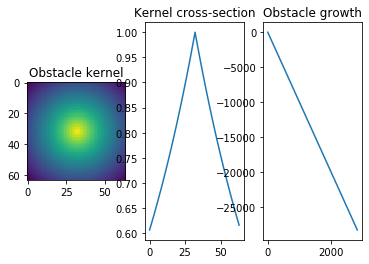

In [8]:
o2 = ObstacleChannel(n=1, r=64, gradient=1)
o2.figure_asset()

In [9]:
get_survival_time(orbium, o2, runs=10, summary=False)

array([2., 2., 2., 2., 2., 2., 2., 2., 2., 0.])

In [13]:
o2.initiate(seed=2)
orbium.enviro = o2.grid
orbium.initiate()
fig = Creature.figure_world(sum([orbium.A, orbium.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, orbium.update_obstacle, frames=200, interval=20).to_jshtml())

This environment is too strong. Need a steeper gradient

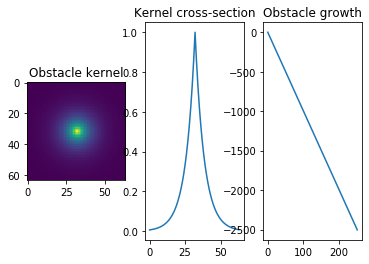

In [14]:
o3 = ObstacleChannel(n=1, r=64, gradient=10)
o3.figure_asset()

In [15]:
get_survival_time(orbium, o3, runs=10, summary=True)

(32.2, 1072.56)

In [17]:
orbium.initiate()
o3.initiate(seed=4)
orbium.enviro = o3.grid
fig = Creature.figure_world(sum([orbium.A, orbium.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, orbium.update_obstacle, frames=200, interval=20).to_jshtml())

The obstacle space above takes up the entire board. 

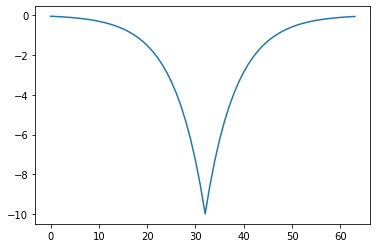

In [18]:
o3.grid = o3.kernel[32, :]
o3.growth()
plt.plot(o3.growth())

In [19]:
evolved_orbium = Creature("orbium_t600_s0n100_enviro_static_gradient_r60_10")

In [20]:
obstacle = ObstacleChannel(n=1, r=60, gradient=10)
te = get_survival_time(evolved_orbium, obstacle, summary=False)

In [21]:
to = get_survival_time(orbium, obstacle, summary=False)

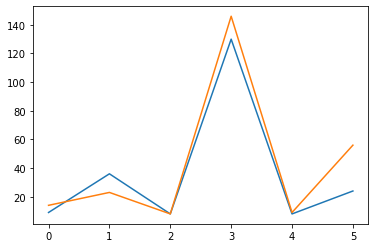

In [22]:
plt.plot(to[0:6])
plt.plot(te[0:6])

In [23]:
obstacle.initiate(seed=4)
orbium.initiate()
evolved_orbium.initiate()
evolved_orbium.enviro = obstacle.grid
fig = Creature.figure_world(sum([evolved_orbium.A, evolved_orbium.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, evolved_orbium.update_obstacle, frames=200, interval=20).to_jshtml())

In [25]:
orbium.initiate()
orbium.enviro = obstacle.grid
fig = Creature.figure_world(sum([orbium.A, orbium.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, orbium.update_obstacle, frames=200, interval=20).to_jshtml())

See a slight recovery in our evolved orbium... perhaps due to slightly higher growth mean

In [24]:
print(orbium.theta())
print(evolved_orbium.theta())  # Slightly larger mean growth

[13.0, 10.0, 0.015, 0.15, [1.0]]
[13.0, 10.0, 0.019838610107210858, 0.15, [1.0]]


In [30]:
## EVOLVED FOR 30 minutes
evolved2 = Creature("orbium_t1800_s0n100_enviro_static_gradient_10_r60_")
evolved2.theta()

[12.804393693263991, 10.0, 0.019838610107210858, 0.1337146775242871, [1.0]]

In [31]:
te2 = get_survival_time(evolved2, obstacle, summary=False)

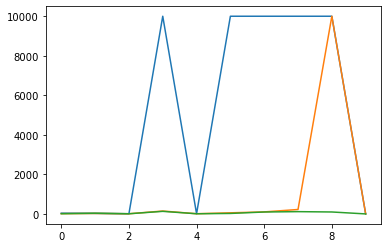

In [34]:
plt.plot(te2)
plt.plot(te)
plt.plot(to)

In [56]:
evolved2.initiate()
obstacle.initiate(seed=4)
evolved2.enviro= obstacle.grid
fig = Creature.figure_world(sum([evolved2.A, evolved2.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, evolved2.update_obstacle, frames=200, interval=20).to_jshtml())

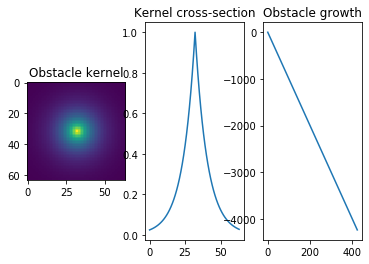

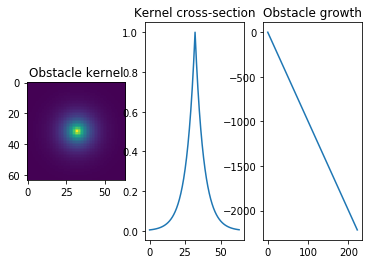

In [64]:
## Make gradient more intense
obstacle2 = ObstacleChannel(n=1, r=60, gradient=7) # much more deadly
obstacle2.figure_asset()
obstacle.figure_asset()

In [65]:
obstacle2.initiate(seed=4)
evolved2.initiate()
evolved2.enviro = obstacle2.grid
fig = Creature.figure_world(sum([evolved2.A, evolved2.enviro]))
IPython.display.HTML(animation.FuncAnimation(fig, evolved2.update_obstacle, frames=200, interval=20).to_jshtml())